In [1]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import pandas as pd
import numpy as np
import cv2
import os
import torch
import albumentations as A
import imageio.v2 as imageio
import matplotlib.pyplot as plt
from dataset import *
from model import *
from torchsummary import summary
from torch_snippets import *
DF_PATH = "metadata.csv"
DEVICE= torch.device("cuda" if torch.cuda.is_available() else "cpu")
df = pd.read_csv(DF_PATH)

In [2]:
df_val = df[3680:]

### Load Generator Model

In [3]:
generator = GeneratorUNet().to(DEVICE)
g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
epochs_performed = 10
model_path = f'models/generator_model_{epochs_performed}_epochs.pth'
check_point = torch.load(model_path)
generator.load_state_dict(check_point['model_state_dict'])
g_optimizer.load_state_dict(check_point['optimizer_state_dict'])

In [4]:
val_dataset = SAR2OpticalDataset(df_val, train=True, optical_rgb=False , device=DEVICE)
val_dl = DataLoader(val_dataset, batch_size=20, shuffle=True, drop_last=False)

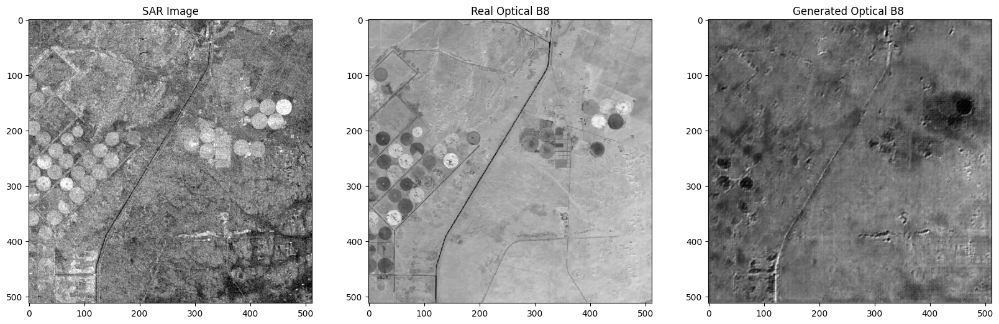

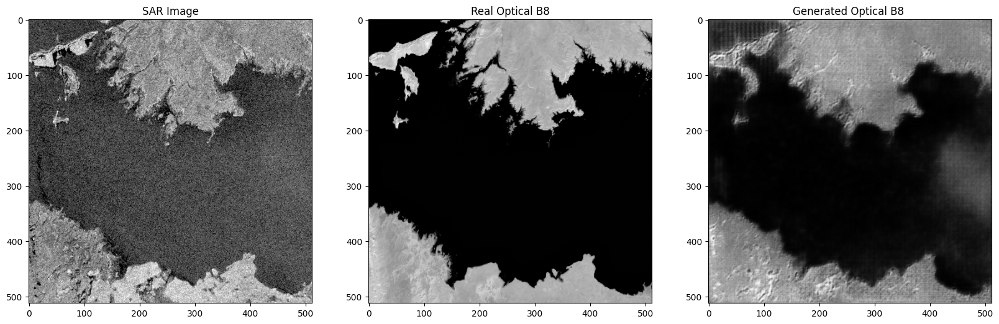

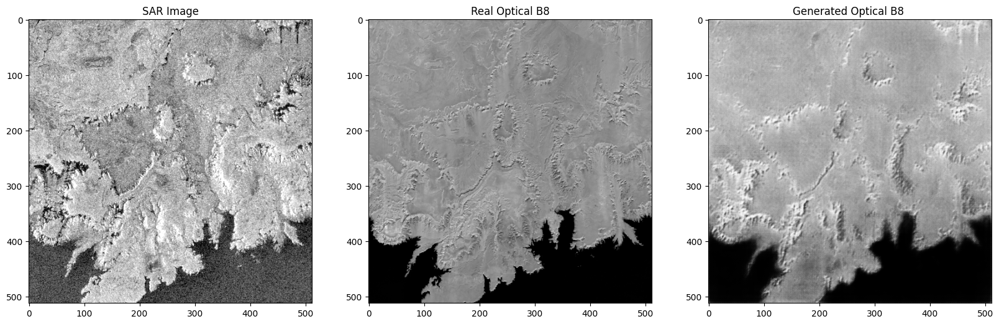

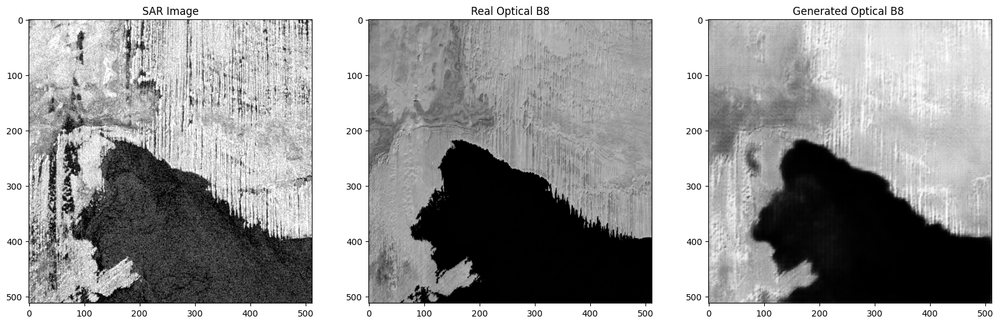

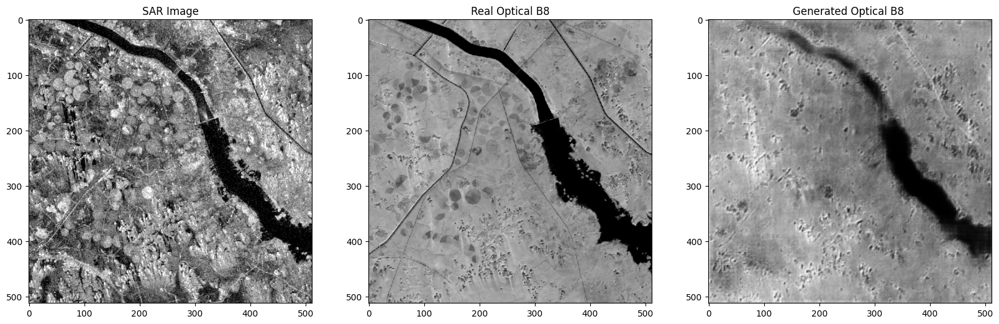

...

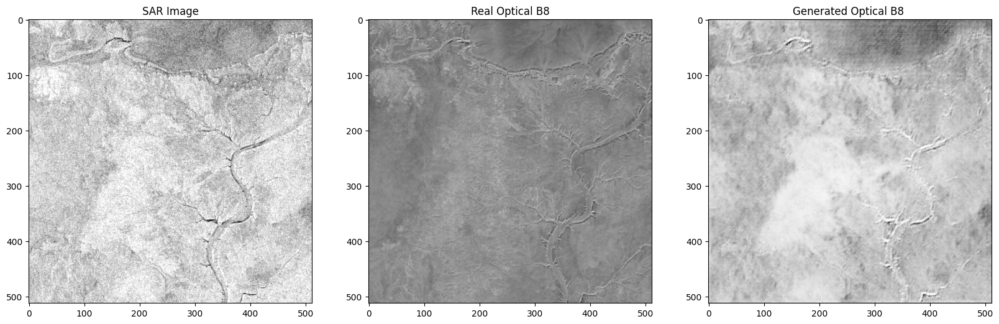

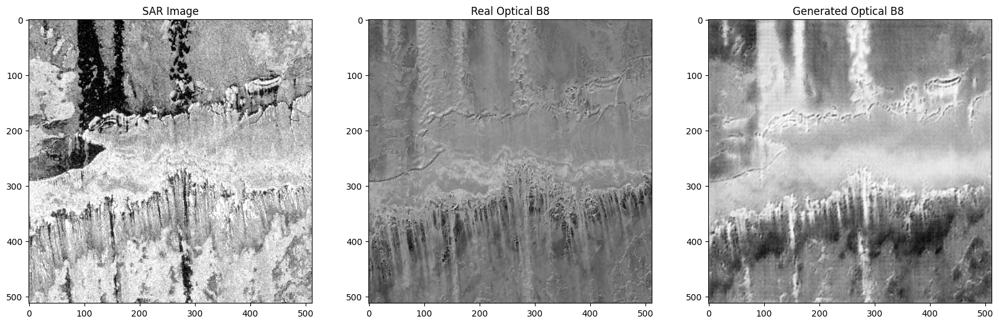

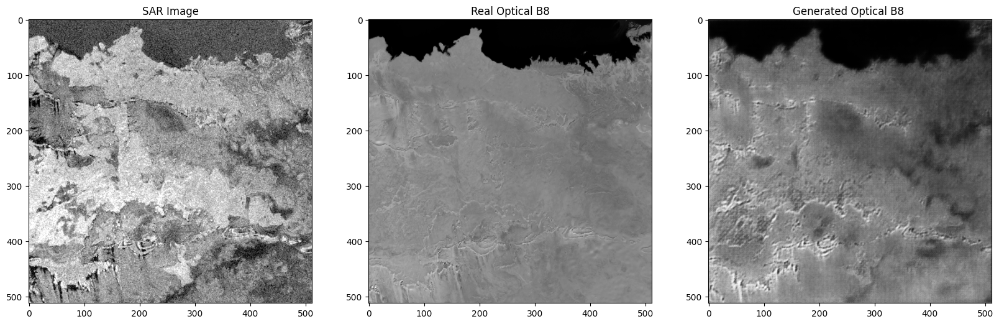

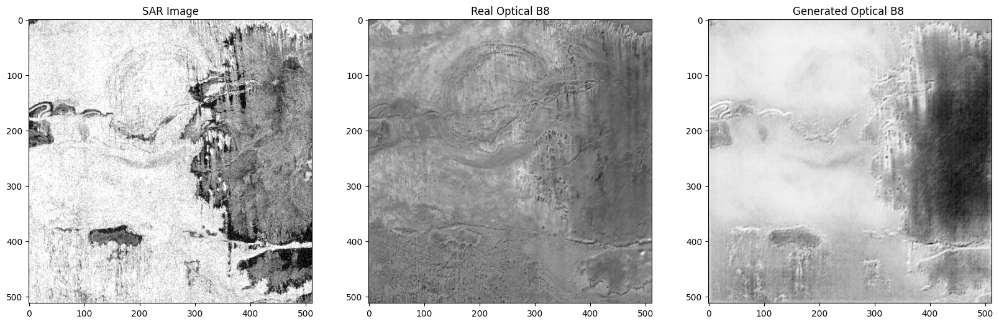

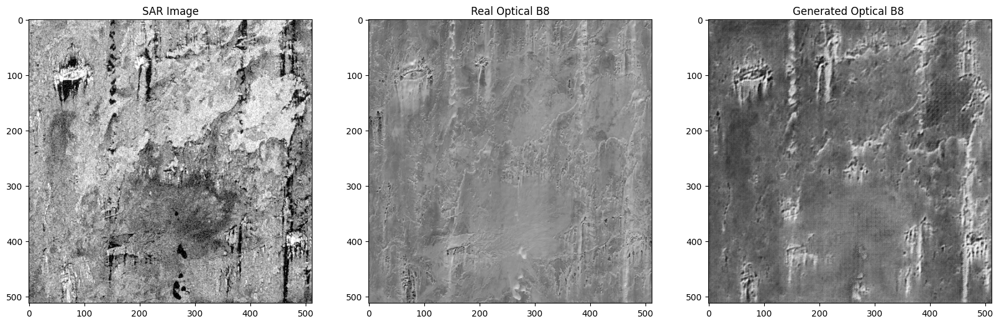

In [5]:
batch = next(iter(val_dl))
real_src, real_trg = batch
generator.eval()
fake_trg = generator(real_src)
sar_ds_mean = 12.29
sar_ds_st = 5.27
b8_ds_mean = 132.99
b8_ds_st = 37.32

for i in range(20):
    sar_image = real_src[i].detach().cpu().permute(1,2,0).numpy()
    real_b8 = real_trg[i].detach().cpu().permute(1,2,0).numpy()
    fake_b8 = fake_trg[i].detach().cpu().permute(1,2,0).numpy()
    denorm_sar_image = (sar_image * sar_ds_st) + sar_ds_mean
    denorm_real_b8 = (real_b8 * b8_ds_st) + b8_ds_mean
    denorm_fake_b8 = (fake_b8 * b8_ds_st) + b8_ds_mean
    plt.figure(figsize=(20,60))
    plt.subplot(1,3,1)
    plt.title("SAR Image")
    plt.imshow(denorm_sar_image , cmap='gray')
    plt.subplot(1,3,2)
    plt.title("Real Optical B8")
    plt.imshow(denorm_real_b8 , cmap='gray')
    plt.subplot(1,3,3)
    plt.title("Generated Optical B8 ")
    plt.imshow(denorm_fake_b8 , cmap='gray')
    plt.show()